# Component 2. Fuel Consumption Rating

## 2. Building the model

In [2]:
#packages to help in data exploration and machine learning

import pandas as pd # for reading csv file
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split #Enables us split the data into training and testing
from sklearn.preprocessing import MinMaxScaler # To scale the dataset


from sklearn.linear_model import LinearRegression   # Importing the model 
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score


from sklearn.model_selection import cross_validate, KFold, cross_val_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score

In [3]:
#Reading in the csv file to load data

fuel_consumption = pd.read_csv('MY2010-2014 Fuel Consumption Ratings 5-cycle_new.csv')

In [4]:
#Information about the dataset to check datatype, number of features and obeservations

fuel_consumption.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5359 entries, 0 to 5358
Data columns (total 13 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   MODEL YEAR                         5359 non-null   int64  
 1   MAKE                               5359 non-null   object 
 2   MODEL # = high output engine       5359 non-null   object 
 3   VEHICLE CLASS                      5359 non-null   object 
 4   ENGINE SIZE (L)                    5359 non-null   float64
 5   CYLINDERS                          5359 non-null   int64  
 6   TRANSMISSION                       5359 non-null   object 
 7   FUEL TYPE                          5359 non-null   object 
 8   FUEL CONSUMPTION* CITY (L/100 km)  5359 non-null   float64
 9    HWY (L/100 km)                    5359 non-null   float64
 10   COMB (L/100 km)                   5359 non-null   float64
 11   COMB (mpg)                        5359 non-null   int64

In [5]:
#Using the attribute shape to get the features and observations
fuel_consumption.shape

(5359, 13)

In [6]:
#Checking the dataset for nulls
fuel_consumption.isnull().sum()

MODEL YEAR                           0
MAKE                                 0
MODEL # = high output engine         0
VEHICLE CLASS                        0
ENGINE SIZE (L)                      0
CYLINDERS                            0
TRANSMISSION                         0
FUEL TYPE                            0
FUEL CONSUMPTION* CITY (L/100 km)    0
 HWY (L/100 km)                      0
 COMB (L/100 km)                     0
 COMB (mpg)                          0
CO2 EMISSIONS  (g/km)                0
dtype: int64

In [7]:
# Further checking for duplicates
fuel_consumption.duplicated().sum()

0

In [8]:
#Renaming the columns to unambiguous column names
print(fuel_consumption.columns)
fuel_consumption.columns =  ['MODELYEAR', 'MAKE', 'MODEL', 'VEHICLECLASS', 'ENGINESIZE', 'CYLINDERS',
       'TRANSMISSION', 'FUELTYPE', 'FUELCONSUMPTION_CITY',
       'FUELCONSUMPTION_HWY', 'FUELCONSUMPTION_COMB',
       'FUELCONSUMPTION_COMB_MPG', 'CO2EMISSIONS']
print(fuel_consumption.columns)

Index(['MODEL YEAR', 'MAKE ', 'MODEL # = high output engine', 'VEHICLE CLASS ',
       'ENGINE SIZE (L)', 'CYLINDERS ', 'TRANSMISSION ', 'FUEL TYPE',
       'FUEL CONSUMPTION* CITY (L/100 km)', ' HWY (L/100 km)',
       ' COMB (L/100 km)', ' COMB (mpg)', 'CO2 EMISSIONS  (g/km)'],
      dtype='object')
Index(['MODELYEAR', 'MAKE', 'MODEL', 'VEHICLECLASS', 'ENGINESIZE', 'CYLINDERS',
       'TRANSMISSION', 'FUELTYPE', 'FUELCONSUMPTION_CITY',
       'FUELCONSUMPTION_HWY', 'FUELCONSUMPTION_COMB',
       'FUELCONSUMPTION_COMB_MPG', 'CO2EMISSIONS'],
      dtype='object')


In [9]:
# Checking the first five rows
fuel_consumption.head()

,MODELYEAR,MAKE,MODEL,VEHICLECLASS,ENGINESIZE,CYLINDERS,TRANSMISSION,FUELTYPE,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS
0,2010,ACURA,CSX,COMPACT,2.0,4,AS5,X,10.9,7.8,9.5,30,219
1,2010,ACURA,CSX,COMPACT,2.0,4,M5,X,10.0,7.6,8.9,32,205
2,2010,ACURA,CSX,COMPACT,2.0,4,M6,Z,11.6,8.1,10.0,28,230
3,2010,ACURA,MDX AWD,SUV,3.7,6,AS6,Z,14.8,11.3,13.2,21,304
4,2010,ACURA,RDX AWD TURBO,SUV,2.3,4,AS5,Z,13.2,10.3,11.9,24,274


###### Checking the distribution

<Figure size 1280x960 with 0 Axes>

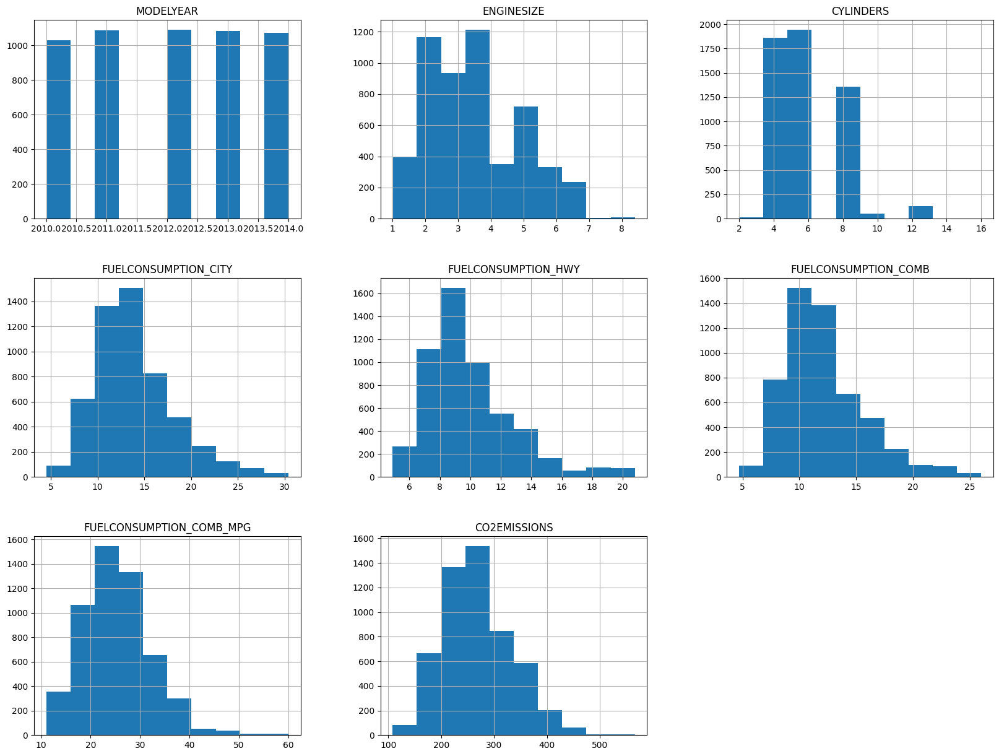

In [10]:

#fig, ax = plt.subplots(nrows=3, ncols=3, sharey = False)
#df.plot(kind = 'hist', subplots = True, sharex = False, sharey = False, figsize=(15,20) )
plt.figure(dpi=200)
fuel_consumption.hist(figsize = (20,15))
plt.show()
#plt.subplots_adjust(wspace = 0.5, hspace = 0.5)

The distribution for CYLINDERS appears to be discrete
The distribution of MODELYEAR appears to be static, while
The distribution for FUELCONSUMPTION_CITY, FUELCONSUMPTION_HWY, FUELCONSUMPTION_COMB appears to be right skewed.

In [11]:
# Getting the numeric variables for the training data
fuel_numeric = fuel_consumption.select_dtypes(exclude = 'object')

In [12]:
# Confirming the numeric variables through the first five values of the dataset

fuel_numeric.head()

,MODELYEAR,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS
0,2010,2.0,4,10.9,7.8,9.5,30,219
1,2010,2.0,4,10.0,7.6,8.9,32,205
2,2010,2.0,4,11.6,8.1,10.0,28,230
3,2010,3.7,6,14.8,11.3,13.2,21,304
4,2010,2.3,4,13.2,10.3,11.9,24,274


In [13]:
fuel_numeric.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5359 entries, 0 to 5358
Data columns (total 8 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   MODELYEAR                 5359 non-null   int64  
 1   ENGINESIZE                5359 non-null   float64
 2   CYLINDERS                 5359 non-null   int64  
 3   FUELCONSUMPTION_CITY      5359 non-null   float64
 4   FUELCONSUMPTION_HWY       5359 non-null   float64
 5   FUELCONSUMPTION_COMB      5359 non-null   float64
 6   FUELCONSUMPTION_COMB_MPG  5359 non-null   int64  
 7   CO2EMISSIONS              5359 non-null   int64  
dtypes: float64(4), int64(4)
memory usage: 335.1 KB


In [14]:
# Ascertaining the features and obesrvations in the numeric dataset

fuel_numeric.shape

(5359, 8)

###### Creating functions for building the model

In [15]:
# A function that accepts the data dataframe , split the data and then normalize

def data_process(dataframe, label):
    
    # Separating the data into features and the target
    # features do not include the component we are trying to predict. 
    # target is the component we want to predict
    
    features = dataframe.drop(label, axis=1)
    target = dataframe[label]
    
    # Split into training and test
    
    X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=0)
    
    # Further split the training data to 20% validation data
    
    X,y = X_train, y_train
    
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=0)
    
    # Instantiate the scaler
    
    scaler = MinMaxScaler() # Instantiate the scaler object

    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)
    X_test_scaled = scaler.transform(X_test)
    
    # Put into a dataframe
    X_train_scaled = pd.DataFrame(X_train_scaled, columns = X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns = X_test.columns)
    X_val_scaled = pd.DataFrame(X_val_scaled, columns = X_val.columns)
    
    return X_train_scaled,X_test_scaled,X_val_scaled, y_train,y_test,y_val
    

In [16]:
# A function to build the model to predict CO2EMISSIONS
def reg_model(var):
    # Get the normalized data
    X_train_scaled,X_test_scaled,X_val_scaled, y_train,y_test,y_val = data_process(fuel_numeric,'CO2EMISSIONS')
    
    # Instantiate the model
    model = LinearRegression()
    

    # Train the model
    model.fit(X_train_scaled[var], y_train)
    
    # Make predictions
    basem_preds = model.predict(X_test_scaled[var])
    
    # Check the errors
    mean_abs = mean_absolute_error(y_test, basem_preds)
    mean_squared = mean_squared_error(y_test, basem_preds)
    print(f'The result of the mean absolute error is: {mean_abs:.2f}')
    print(f'The result of the mean squared error is: {np.sqrt(mean_squared):.2f}')
    print(f'The result of the coefficient of determination is: {r2_score(y_test, basem_preds):.2f}')
    print('Training accuracy: {:.4f}'.format(model.score(X_train_scaled[var],y_train)))
    print('Testing accuracy: {:.4f}'.format(model.score(X_test_scaled[var],y_test)))



###### Attempting to build a model with all the continuous numerical variables

Using each of the numerical continuous variables to build a model to predict CO2EMISSION

In [17]:
reg_model(['ENGINESIZE'])

The result of the mean absolute error is: 24.05
The result of the mean squared error is: 32.10
The result of the coefficient of determination is: 0.74
Training accuracy: 0.7375
Testing accuracy: 0.7359


In [18]:
reg_model(['MODELYEAR'])

The result of the mean absolute error is: 49.75
The result of the mean squared error is: 62.35
The result of the coefficient of determination is: 0.00
Training accuracy: 0.0174
Testing accuracy: 0.0039


In [19]:
reg_model(['CYLINDERS'])

The result of the mean absolute error is: 27.47
The result of the mean squared error is: 35.78
The result of the coefficient of determination is: 0.67
Training accuracy: 0.7153
Testing accuracy: 0.6720


In [20]:
reg_model(['FUELCONSUMPTION_CITY'])

The result of the mean absolute error is: 20.06
The result of the mean squared error is: 28.89
The result of the coefficient of determination is: 0.79
Training accuracy: 0.7964
Testing accuracy: 0.7862


In [21]:
reg_model(['FUELCONSUMPTION_HWY'])

The result of the mean absolute error is: 24.41
The result of the mean squared error is: 33.25
The result of the coefficient of determination is: 0.72
Training accuracy: 0.7349
Testing accuracy: 0.7167


In [22]:
reg_model(['FUELCONSUMPTION_COMB'])

The result of the mean absolute error is: 20.79
The result of the mean squared error is: 29.75
The result of the coefficient of determination is: 0.77
Training accuracy: 0.7857
Testing accuracy: 0.7733


In [23]:
reg_model(['FUELCONSUMPTION_COMB_MPG'])

The result of the mean absolute error is: 17.37
The result of the mean squared error is: 26.14
The result of the coefficient of determination is: 0.82
Training accuracy: 0.8029
Testing accuracy: 0.8250


#### Exploratory Data Analysis

<AxesSubplot: >

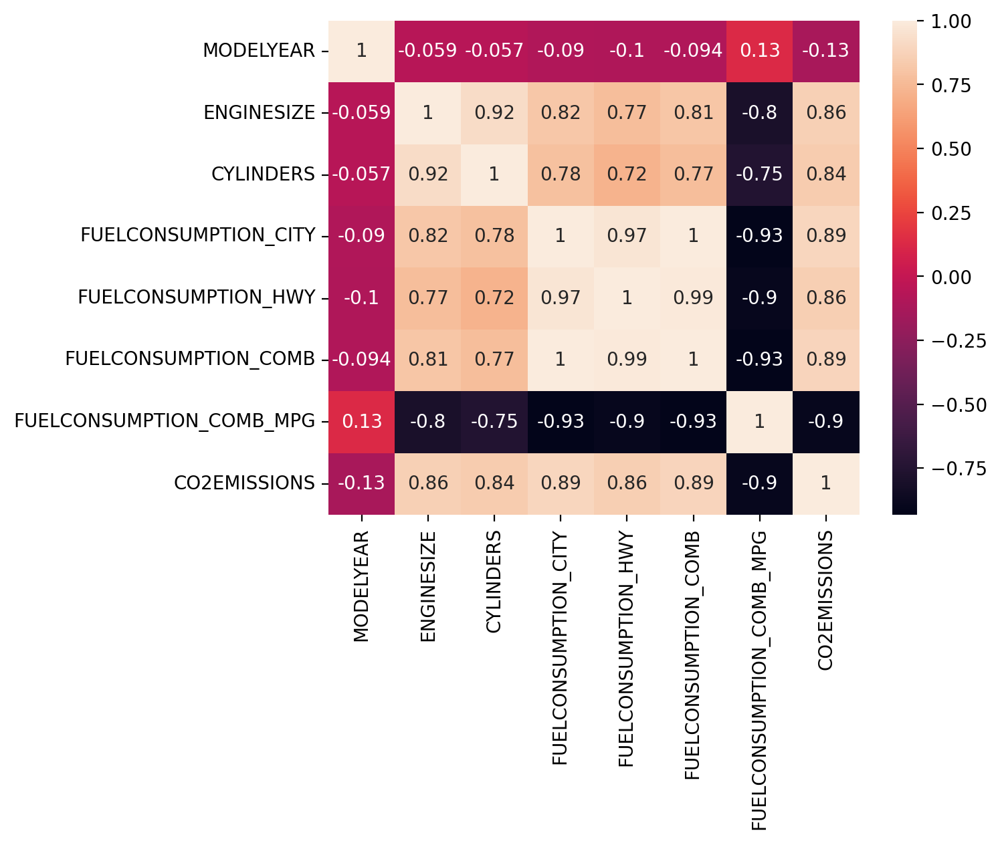

In [24]:
plt.figure(dpi=200)


# checking for correlation to see if any of the variables have strong relationship
sns.heatmap(fuel_numeric.corr(), annot = True) 

In [25]:
fuel_numeric.columns

Index(['MODELYEAR', 'ENGINESIZE', 'CYLINDERS', 'FUELCONSUMPTION_CITY',
       'FUELCONSUMPTION_HWY', 'FUELCONSUMPTION_COMB',
       'FUELCONSUMPTION_COMB_MPG', 'CO2EMISSIONS'],
      dtype='object')

The heatmap shows a strong correlation among all the variables except the MODELYEAR

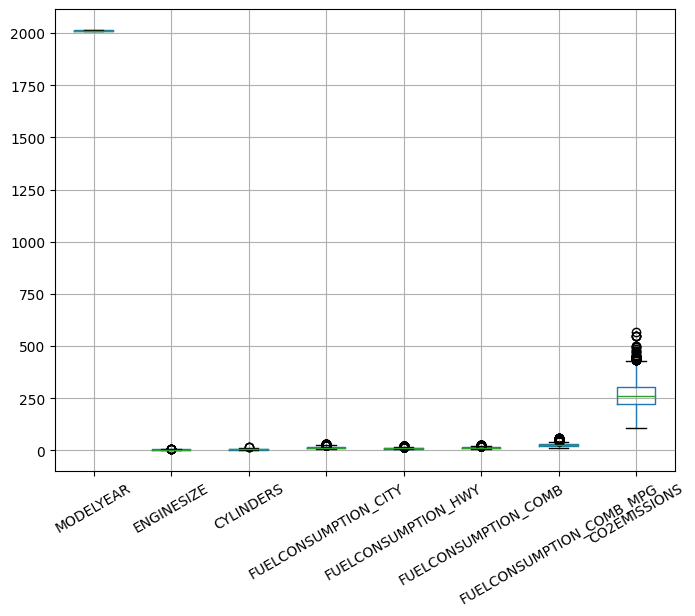

In [26]:
#fuel_numeric boxplot()
fuel_numeric.boxplot(figsize = (8,6), fontsize = 10, rot=30)
plt.show()

The boxplot shows that some variables exert dominance over the others hence the need for scaling.

After Exploratory Data Analysis, and looking at features with high correlations, the following three features will be combined to build the model

###### Selecting a subset of the variables to build a model

In [27]:
reg_model(['ENGINESIZE', 'CYLINDERS', 'FUELCONSUMPTION_COMB_MPG'])

The result of the mean absolute error is: 15.47
The result of the mean squared error is: 22.41
The result of the coefficient of determination is: 0.87
Training accuracy: 0.8702
Testing accuracy: 0.8713


## 3. CO2 Emission Trends

<AxesSubplot: xlabel='MODELYEAR', ylabel='CO2EMISSIONS'>

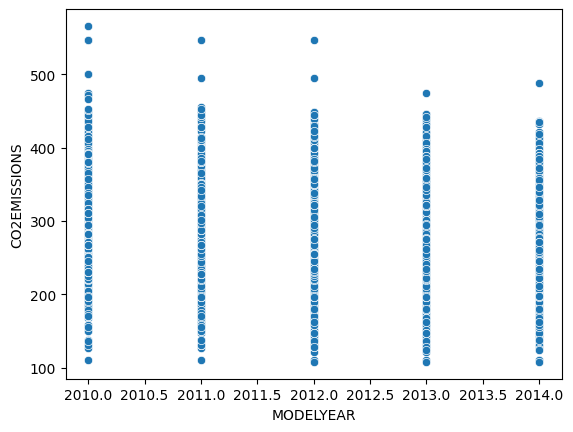

In [28]:
# Finding the changes in CO2 Emissions

sns.scatterplot(x='MODELYEAR', y='CO2EMISSIONS', data=fuel_numeric)

## 4. Using each categorical variable as target

In [29]:
fuel_object = fuel_consumption.select_dtypes(include='object') # Select all datatypes object
fuel_object

,MAKE,MODEL,VEHICLECLASS,TRANSMISSION,FUELTYPE
0,ACURA,CSX,COMPACT,AS5,X
1,ACURA,CSX,COMPACT,M5,X
2,ACURA,CSX,COMPACT,M6,Z
3,ACURA,MDX AWD,SUV,AS6,Z
4,ACURA,RDX AWD TURBO,SUV,AS5,Z
...,...,...,...,...,...
5354,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5355,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5356,VOLVO,XC70 AWD,SUV - SMALL,AS6,X
5357,VOLVO,XC70 AWD,SUV - SMALL,AS6,X


Convert all “non-null object” columns to dummy variables using the label encoding

In [30]:
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE

In [31]:
le = LabelEncoder() #instantiates the object

# Applies the object to data
le_data = le.fit_transform(fuel_object[['MAKE']])

# Create a dataframe
df_le = pd.DataFrame(le_data, columns=['MAKE'])

fuel_consumption_new = pd.concat([fuel_numeric, df_le], axis=1)

#On the MODEL column
le_data = le.fit_transform(fuel_object[['MODEL']])

# Create a dataframe
df_le = pd.DataFrame(le_data, columns=['MODEL'])

fuel_consumption_new = pd.concat([fuel_consumption_new, df_le], axis=1)


# On the VEHICLECLASS column
le_data = le.fit_transform(fuel_object[['VEHICLECLASS']])

# Create a dataframe
df_le = pd.DataFrame(le_data, columns=['VEHICLECLASS'])

fuel_consumption_new = pd.concat([fuel_consumption_new, df_le], axis=1)

# On the TRANSMISSION column
le_data = le.fit_transform(fuel_object[['TRANSMISSION']])

# Create a dataframe
df_le = pd.DataFrame(le_data, columns=['TRANSMISSION'])

fuel_consumption_new = pd.concat([fuel_consumption_new, df_le], axis=1)

# On the FUELTYPE column
le_data = le.fit_transform(fuel_object[['FUELTYPE']])

# Create a dataframe
df_le = pd.DataFrame(le_data, columns=['FUELTYPE'])

fuel_consumption_new = pd.concat([fuel_consumption_new, df_le], axis=1)
fuel_consumption_new

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\preprocessing\_label.py:115: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\preprocessing\_label.py:115: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\preprocessing\_label.py:115: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\preprocessing\

,MODELYEAR,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS,MAKE,MODEL,VEHICLECLASS,TRANSMISSION,FUELTYPE
0,2010,2.0,4,10.9,7.8,9.5,30,219,0,352,0,10,2
1,2010,2.0,4,10.0,7.6,8.9,32,205,0,352,0,19,2
2,2010,2.0,4,11.6,8.1,10.0,28,230,0,352,0,20,3
3,2010,3.7,6,14.8,11.3,13.2,21,304,0,734,11,11,3
4,2010,2.3,4,13.2,10.3,11.9,24,274,0,884,11,10,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6,13.4,9.8,11.8,24,271,44,1138,12,11,2
5355,2014,3.2,6,13.2,9.5,11.5,25,264,44,1138,12,11,2
5356,2014,3.0,6,13.4,9.8,11.8,24,271,44,1142,12,11,2
5357,2014,3.2,6,12.9,9.3,11.3,25,260,44,1142,12,11,2


### 5, 6, 7 Building the model, checking for overfitting through cross validation and checking performance measures

In [32]:
# Building the model

from sklearn.linear_model import LogisticRegression   # Importing the model 
from sklearn.metrics import (accuracy_score, classification_report, confusion_matrix,
                        ConfusionMatrixDisplay,plot_roc_curve,roc_auc_score)

In [33]:
#Function to delete 
def delete_var(df,target):
    model_df = df.copy()
    target_count  = fuel_consumption_new[target].value_counts()
    rem = target_count[target_count <= 2].index

    for element in rem:
        indexd = model_df[model_df[target] == element].index
        model_df.drop(indexd,inplace = True)
    return model_df

In [34]:
#Build classification model
def classify_data_process(dataframe, label):
    data = delete_var(dataframe,label)
    features = data.drop(label, axis=1)
    target = data[label]
    
    #Applying SMOTE
    sm = SMOTE(random_state=0, k_neighbors=2)
    X_res, y_res = sm.fit_resample(features, target)
    X, y = X_res, y_res #reassigning the balanced dataset to X,y
    
    
    # Split into training and test
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
    
    # Further split the training data to 20% validation data
    
    X,y = X_train, y_train
    
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=0)
    
    # Instantiate the scaler
    
    scaler = MinMaxScaler() # Instantiate the scaler object

    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)
    X_test_scaled = scaler.transform(X_test)
    
    # Put into a dataframe
    X_train_scaled = pd.DataFrame(X_train_scaled, columns = X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns = X_test.columns)
    X_val_scaled = pd.DataFrame(X_val_scaled, columns = X_val.columns)
    
    model=LogisticRegression()
    model.fit(X_train_scaled,y_train)
    basem_preds = model.predict(X_test_scaled)
    conf = confusion_matrix(y_test, basem_preds)
    
    
    # Cross validation to check for overfitting for each model
    kfold = KFold(n_splits=5)
    cv_result = cross_val_score(model,X_train,y_train, cv= kfold, scoring='accuracy')
    print('Mean: ', cv_result.mean())
    print('Standard Deviation: ', cv_result.std())
    
    
    #Performance Measure for each model
    print(classification_report(y_test, basem_preds))
    

In [35]:
classify_data_process(fuel_consumption_new,'MAKE')

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.or

Mean:  0.32819819097951647
Standard Deviation:  0.018172075240037427
              precision    recall  f1-score   support

           0       0.40      0.65      0.49        95
           2       0.76      0.53      0.62       112
           3       0.14      0.07      0.09        86
           4       0.66      0.59      0.62       127
           5       0.47      0.35      0.40       109
           6       1.00      1.00      1.00       107
           7       0.42      0.38      0.40       107
           8       0.27      0.11      0.15       112
           9       0.05      0.02      0.03       100
          10       0.37      0.68      0.48        88
          11       0.14      0.07      0.10        98
          12       0.91      0.98      0.95       114
          13       0.77      1.00      0.87       101
          14       0.26      0.05      0.08       104
          15       0.47      0.60      0.53       113
          16       0.26      0.33      0.29        98
          17

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [36]:
classify_data_process(fuel_consumption_new,'MODEL')

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.or

Mean:  0.1591127305935563
Standard Deviation:  0.04120438802651821
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         7
           2       0.00      0.00      0.00         9
           3       0.00      0.00      0.00         9
           4       0.00      0.00      0.00         8
           6       0.86      1.00      0.92         6
           8       0.22      0.86      0.35         7
          13       0.60      0.60      0.60         5
          14       0.00      0.00      0.00         9
          17       0.00      0.00      0.00         8
          18       0.00      0.00      0.00         6
          20       0.46      0.86      0.60         7
          21       0.00      0.00      0.00         9
          22       0.11      1.00      0.20         6
          25       0.00      0.00      0.00        10
          28       0.00      0.00      0.00         7
          29       0.14      0.20      0.17         5
          40  

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.

In [37]:
classify_data_process(fuel_consumption_new,'VEHICLECLASS')

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.or

Mean:  0.2675389950922839
Standard Deviation:  0.014455708709279664
              precision    recall  f1-score   support

           0       0.12      0.03      0.04       146
           1       0.37      0.34      0.35       155
           2       0.31      0.23      0.27       147
           3       0.43      0.66      0.52       143
           4       0.42      0.42      0.42       152
           5       0.62      0.53      0.57       171
           6       0.59      0.47      0.52       157
           7       0.56      0.62      0.59       185
           8       0.39      0.23      0.29       141
           9       0.36      0.43      0.39       152
          10       0.36      0.28      0.31       155
          11       0.14      0.14      0.14       139
          12       0.26      0.38      0.31       131
          13       0.45      0.51      0.48       152
          14       0.25      0.38      0.30       151
          15       0.62      0.86      0.72       152
          16 

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [38]:
classify_data_process(fuel_consumption_new,'TRANSMISSION')

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.or

Mean:  0.3361696233203867
Standard Deviation:  0.011354705681136517
              precision    recall  f1-score   support

           0       0.50      0.57      0.53       210
           1       0.36      0.26      0.31       234
           2       0.34      0.23      0.28       214
           3       0.38      0.35      0.36       219
           4       0.32      0.35      0.33       212
           5       0.74      1.00      0.85       210
           6       0.93      1.00      0.96       193
           7       0.32      0.33      0.33       224
           8       0.23      0.17      0.20       202
           9       0.53      0.73      0.62       224
          10       0.23      0.19      0.21       214
          11       0.33      0.11      0.17       218
          12       0.26      0.23      0.24       210
          13       0.19      0.10      0.14       210
          15       0.71      0.41      0.52       205
          16       0.55      0.97      0.71       198
          17 

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [39]:
classify_data_process(fuel_consumption_new,'FUELTYPE')

C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.or

Mean:  0.679584773969788
Standard Deviation:  0.03254149085359454
              precision    recall  f1-score   support

           0       0.92      1.00      0.96       540
           1       1.00      1.00      1.00       565
           2       0.72      0.73      0.72       514
           3       0.75      0.68      0.72       512

    accuracy                           0.86      2131
   macro avg       0.85      0.85      0.85      2131
weighted avg       0.85      0.86      0.85      2131



C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Abisola\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.or

#### Clustering

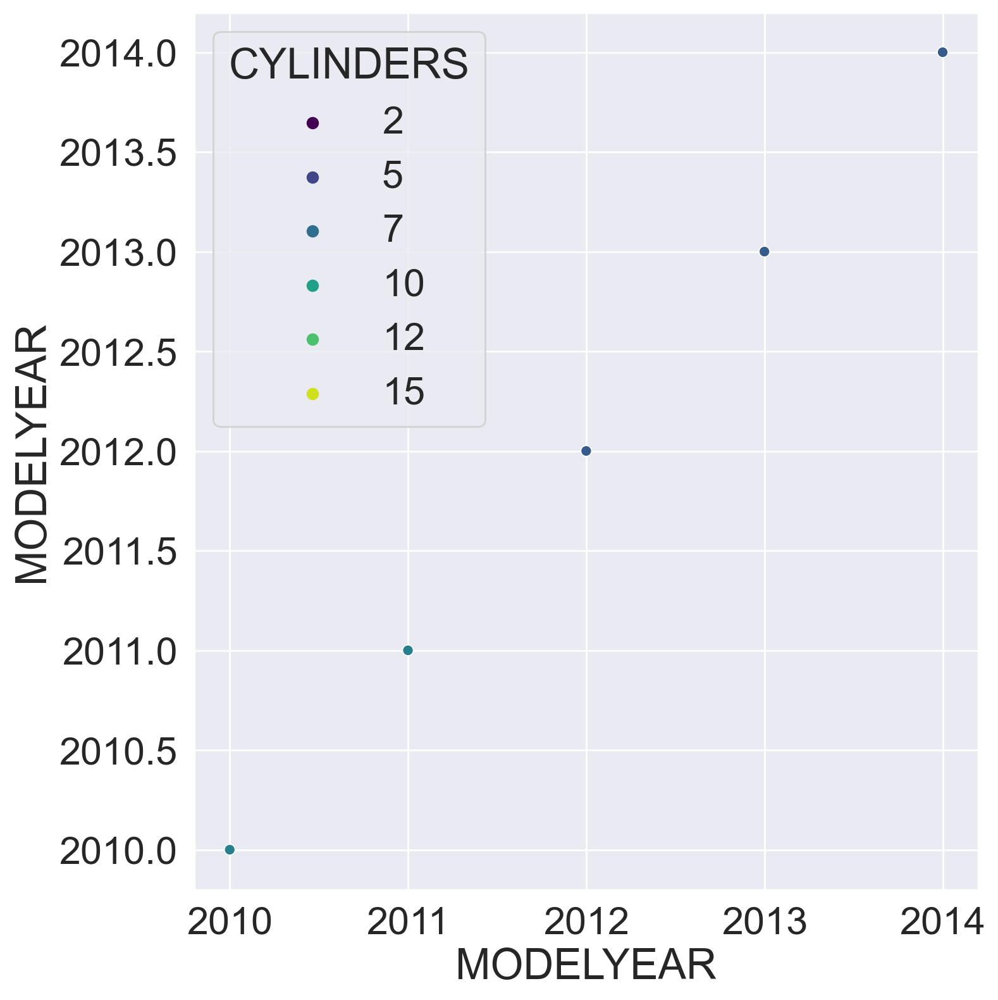

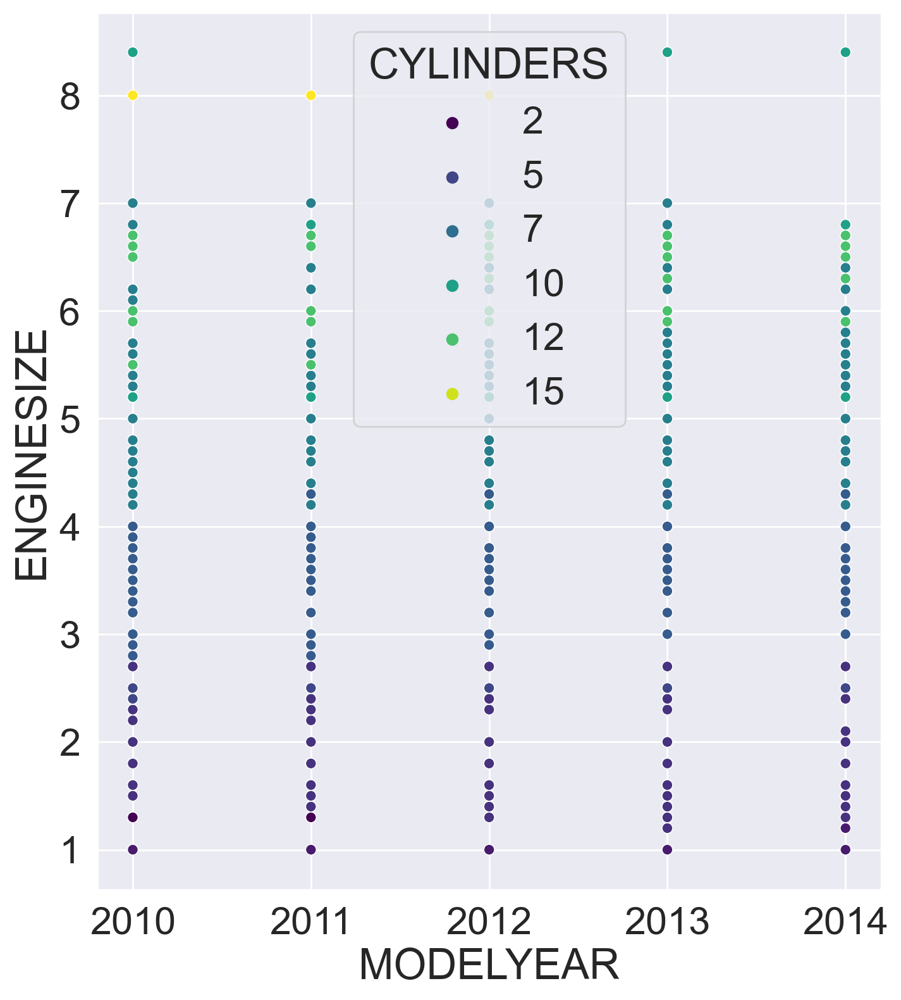

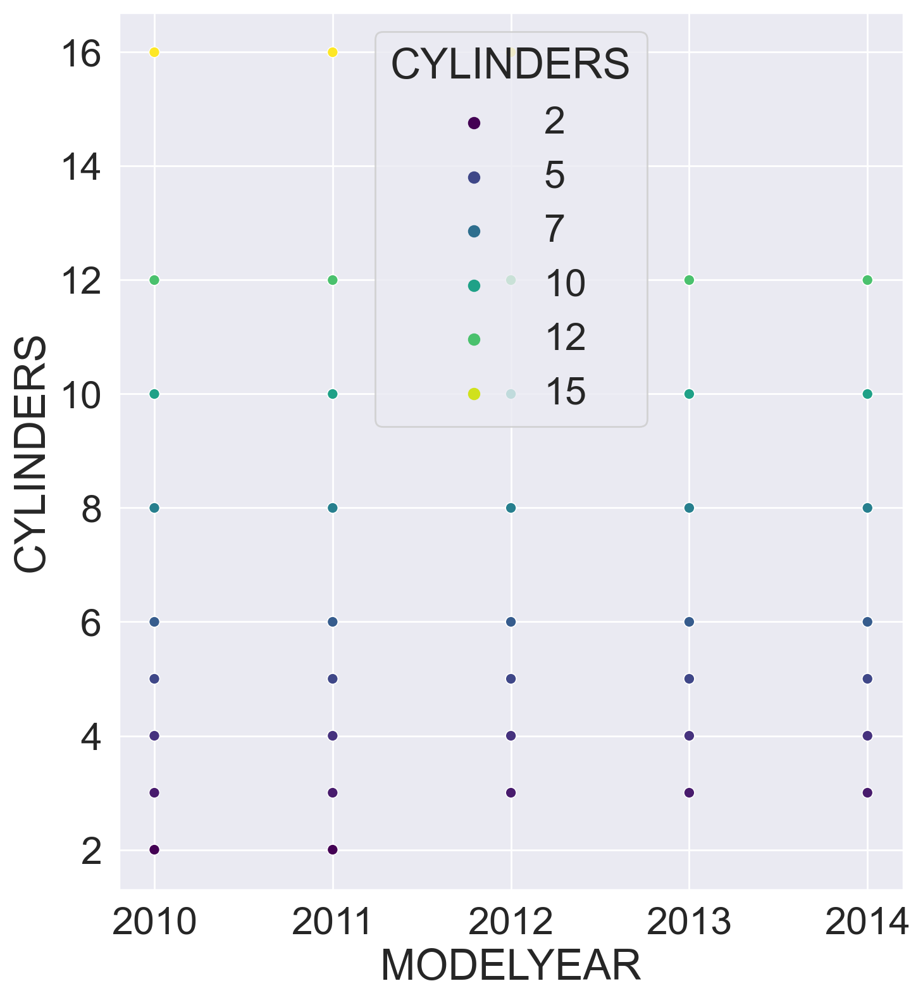

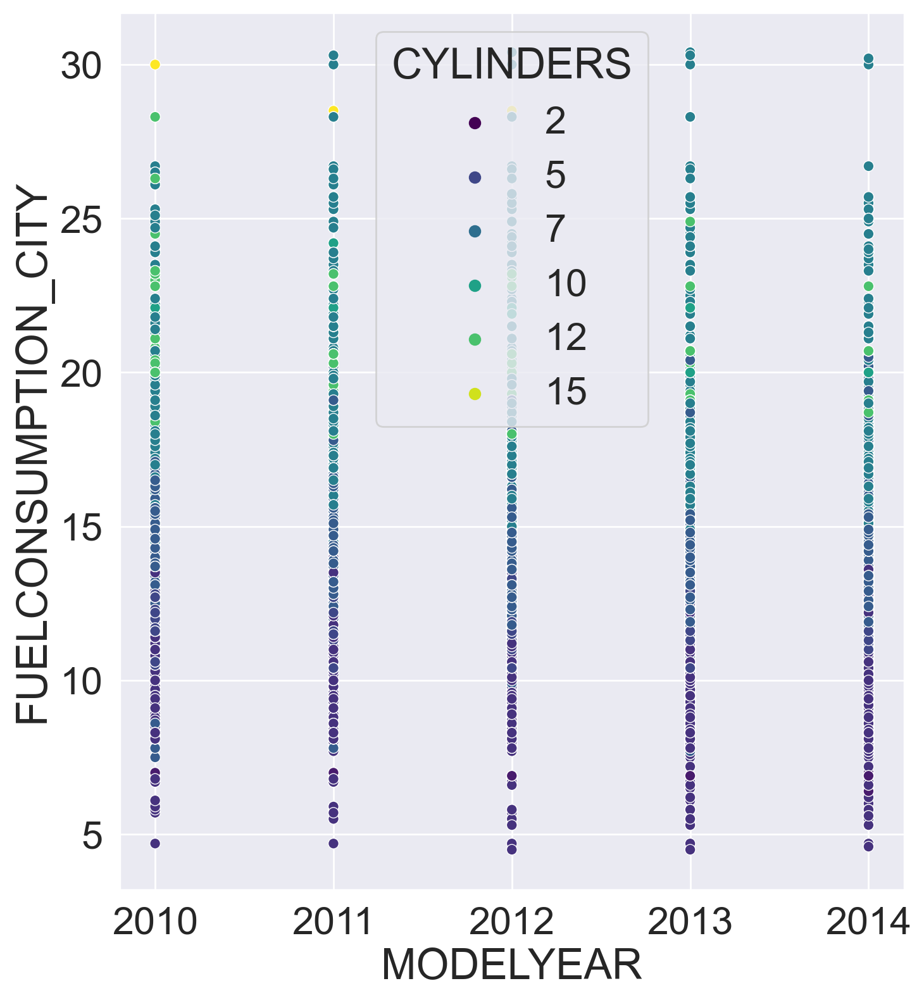

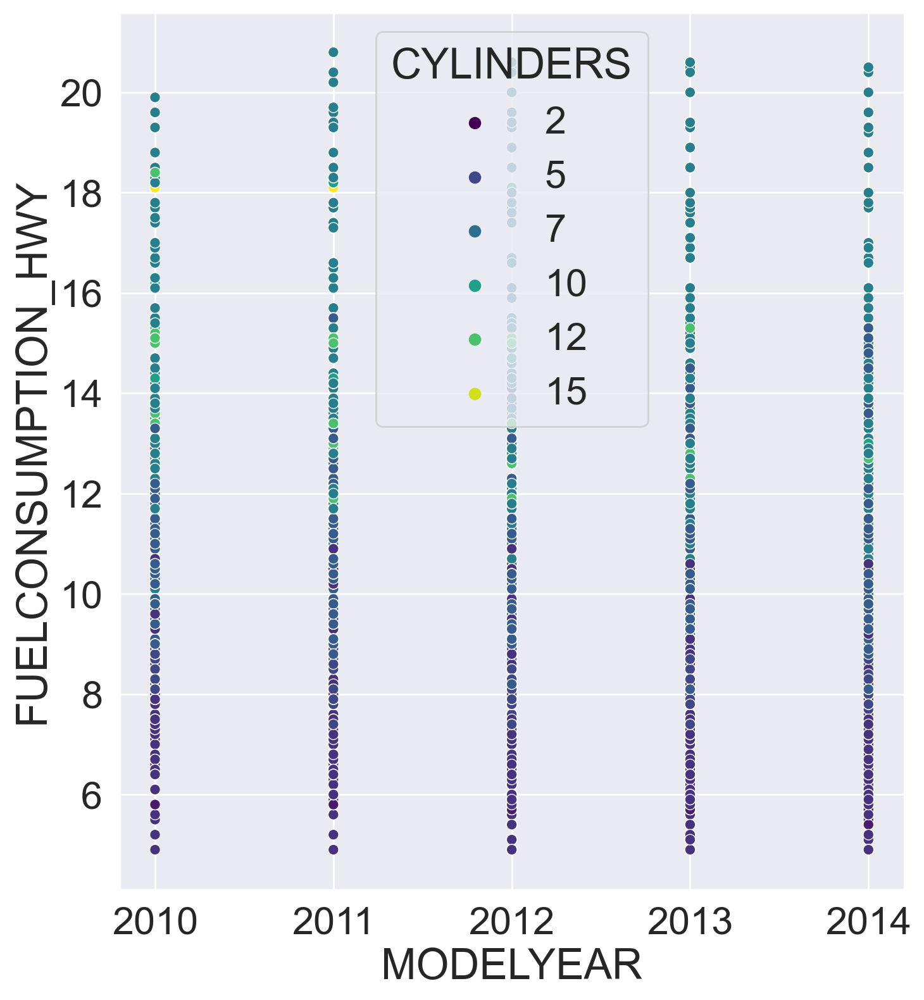

...

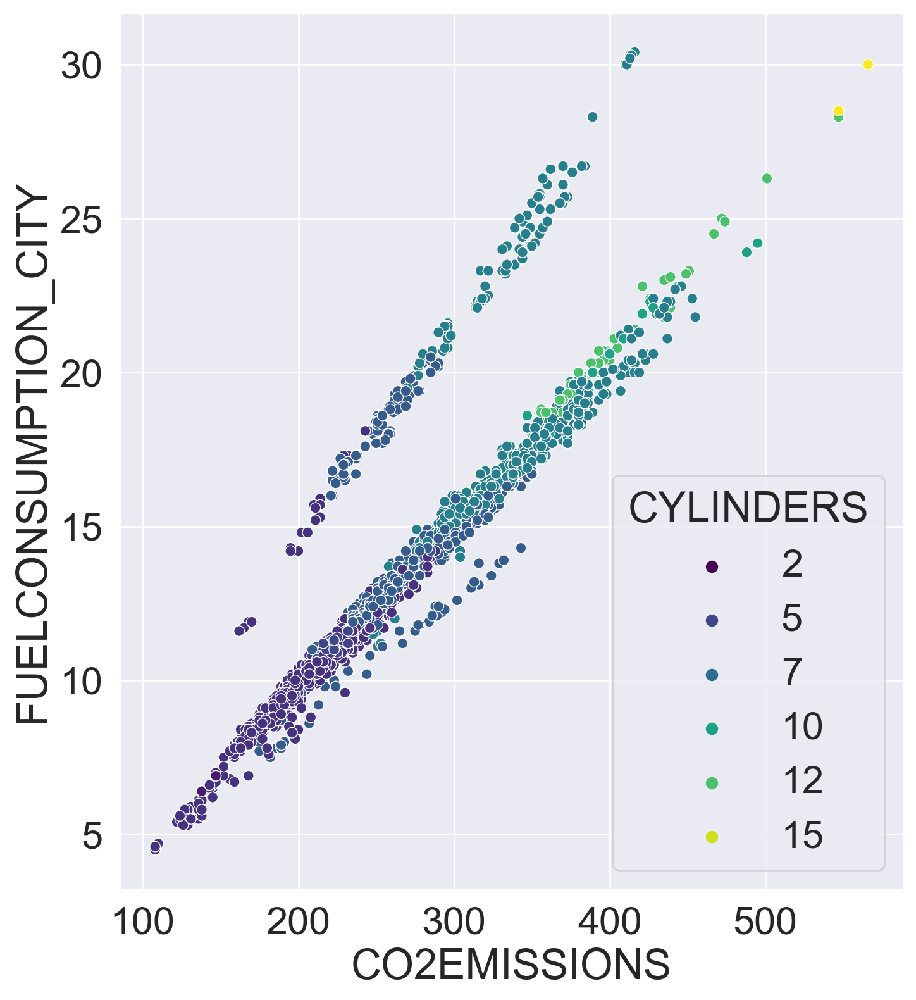

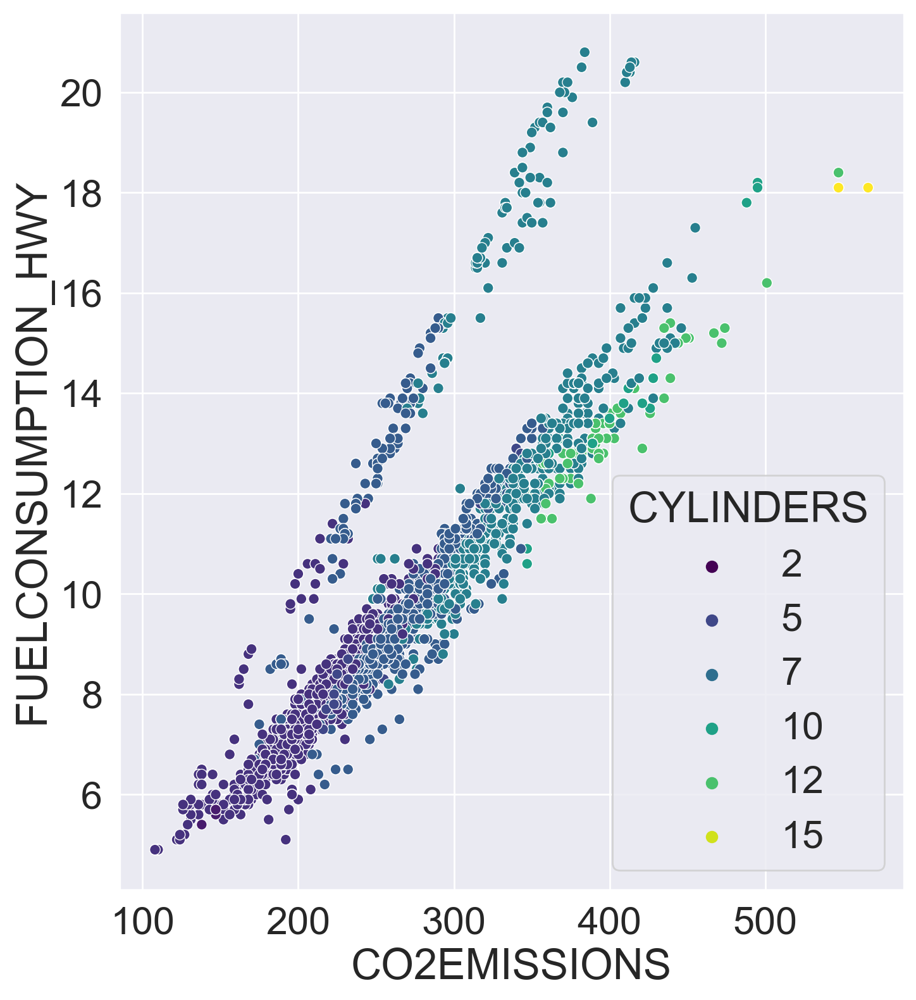

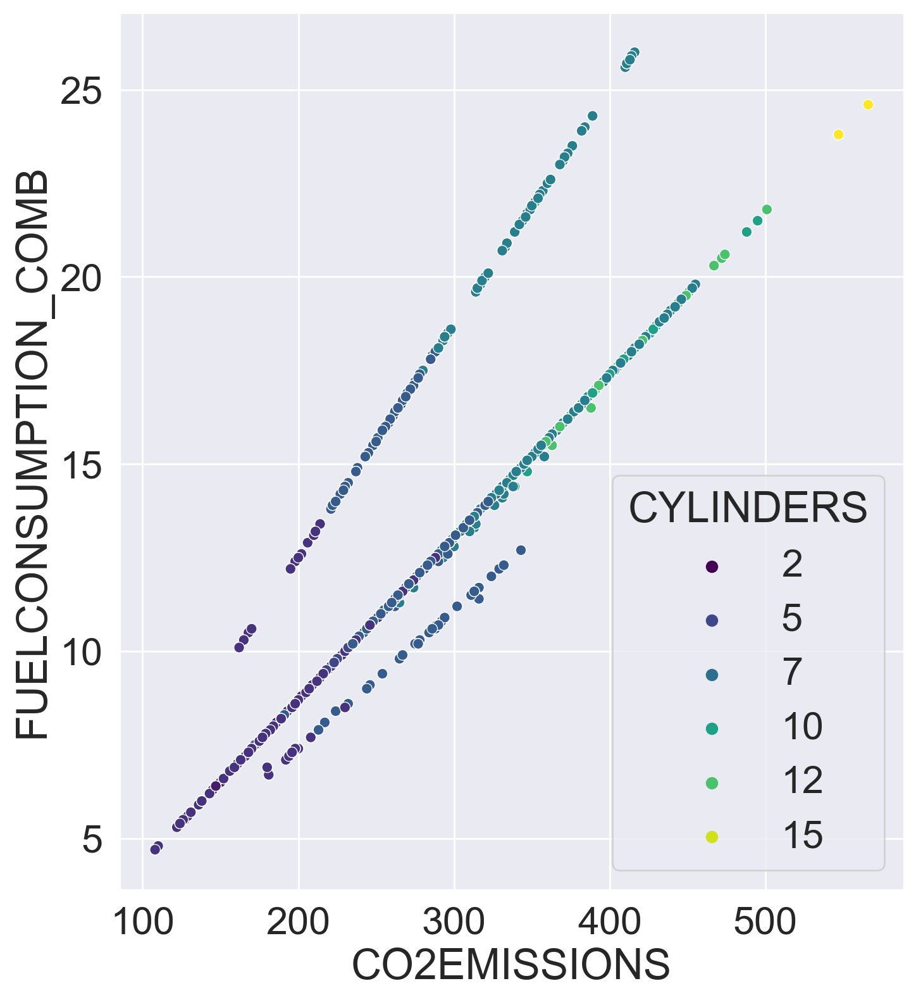

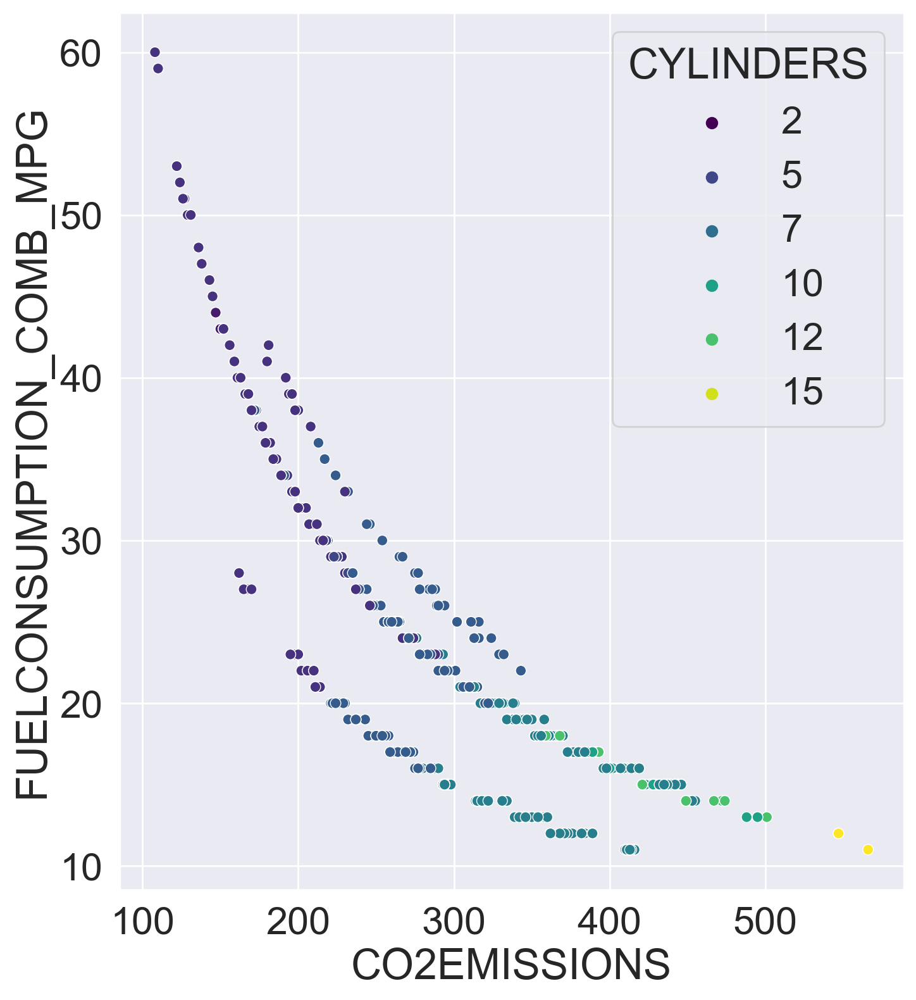

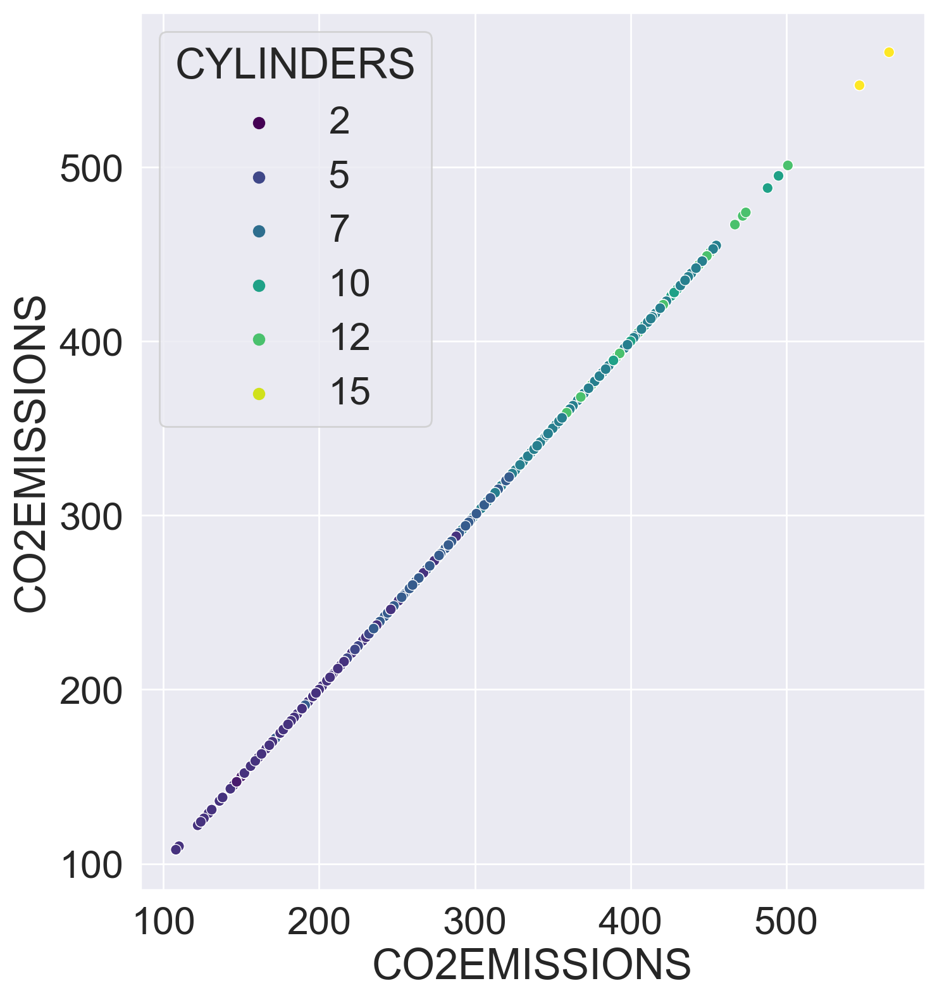

In [43]:
for col1 in fuel_numeric.columns:
    for col2 in fuel_numeric.columns:
        plt.figure(figsize=(8,9), dpi=200)
        sns.set(font_scale=2)
        sns.scatterplot(data = fuel_numeric, x = fuel_numeric[col1],y = fuel_numeric[col2],
         hue='CYLINDERS', palette = 'viridis')
        plt.show()